In [1]:
# to deal with json files
import json 
# numerical opeations
import numpy as np
# storing and processing in a dataframe
import pandas as pd
# geo data operations
import geopandas as gpd
# basic ploting
import matplotlib.pyplot as plt
# interactive plotting
import plotly.express as px

In [2]:
# read geojson data

# file location
geo_json_file_loc = "C:\\Users\\imdevskp\\Documents\\kerala_election\\map\\kerala\\kerala.shp"
# read and store data
gdf = gpd.read_file(geo_json_file_loc)
# first few lines
gdf.head(10)

,AC_NO,AC_NAME,DT_CODE,DIST_NAME,PC_NO,PC_NAME,Shape_Leng,Shape_Area,geometry
0,1,Manjeshwar,1.0,KASARAGOD,1,KASARAGOD,1.410264,0.031505,"POLYGON ((75.00138 12.79192, 75.00555 12.79079..."
1,2,Kasaragod,1.0,KASARAGOD,1,KASARAGOD,1.034167,0.023007,"POLYGON ((75.14544 12.63446, 75.14768 12.63445..."
2,3,Udma,1.0,KASARAGOD,1,KASARAGOD,1.406039,0.038270,"POLYGON ((75.22988 12.56859, 75.23763 12.56978..."
3,4,Kanhangad,1.0,KASARAGOD,1,KASARAGOD,1.528040,0.044015,"POLYGON ((75.34560 12.46276, 75.35926 12.46420..."
4,5,Trikaripur,1.0,KASARAGOD,1,KASARAGOD,1.136716,0.027416,"POLYGON ((75.41050 12.34675, 75.42030 12.31920..."
5,6,Payyannur,2.0,KANNUR,1,KASARAGOD,1.291823,0.030969,"POLYGON ((75.41444 12.29277, 75.42118 12.29217..."
6,7,Kalliasseri,2.0,KANNUR,1,KASARAGOD,0.923668,0.017357,"POLYGON ((75.39407 12.15044, 75.40152 12.14543..."
7,8,Taliparamba,2.0,KANNUR,2,KANNUR,1.124890,0.024565,"POLYGON ((75.39478 12.15300, 75.41662 12.15597..."
8,9,Irikkur,2.0,KANNUR,2,KANNUR,1.483207,0.049223,"POLYGON ((75.49312 12.27419, 75.50564 12.27071..."
9,10,Azhikode,2.0,KANNUR,2,KANNUR,0.427230,0.006602,"POLYGON ((75.38141 11.97507, 75.38456 11.97067..."


In [3]:
# read election data
data = pd.read_csv("C:\\Users\\imdevskp\\Documents\\kerala_election\\2016_election_data\\top_four.csv")
# first few rows
data.head()

,Unnamed: 0,no.,constituency,no._of_voters,turn_out,winner,winner_party,winner_votes,winner_alliance,runner_up,...,runner_up_alliance,third,third_party,third_votes,third_alliance,fourth,fourth_party,fourth_votes,fourth_alliance,lead
0,0,1,Manjeshwar,208104,158886,P. B. Abdul Razak,IUML,56870,UDF,K. Surendran,...,NDA,C. H. Kunhambu,CPIM,42565,LDF,Basheer Ahamad,PDP,759,NaN,89
1,1,2,Kasaragod,188828,144773,N. A. Nellikkunnu,IUML,64727,UDF,Ravisha Thanthri Kuntar,...,NDA,A. A. Ameen,INL,21615,LDF,B. Vijayakumar,BSP,585,NaN,8607
2,2,3,Udma,199775,160909,K. Kunhiraman,CPIM,70679,LDF,K. Sudhakaran,...,UDF,K. Shreekanth,BJP,21231,NDA,Gopi Kuthirakallu,PDP,353,NaN,3832
3,3,4,Kanhangad,204407,161281,E. Chandrasekharan,CPI,80558,LDF,Dhanya Suresh,...,UDF,M. P. Raghavan,BDJS,21104,NDA,Chandran Parappa,BSP,965,NaN,26011
4,4,5,Trikaripur,189819,155720,M. Rajagopalan,CPIM,79286,LDF,K. P. Kunhikannan,...,UDF,M. Bhaskaran,BJP,10767,NDA,C. H. Muthalib,WPI,1029,NaN,16959


In [4]:
# finding non matching constituency names
a, b = set(gdf['AC_NAME']), set(data['constituency'])
print(a-b, b-a, sep='\n\n')

{'Nattika(SC)', 'Sulthanbathery (S', 'Ambalappuzha', 'Kazhakoottam', 'Vypeen', 'Vattiyoorkavu(SC)', 'Mavelikkara (SC)', 'Chelakkara (SC)', 'Nemmara', 'Mananthavady (ST)', 'Attingal (SC)', 'Adoor (SC)', 'Devikulam (SC)', 'Kunnathur (SC)', 'Vaikom (SC)', 'Tarur (SC)', 'Ottappalam', 'Chalakudy', 'Kongad(SC)', 'Punalur', 'Thiruvananthapura', 'Wandoor (SC)', 'Thiruvambadi', 'Vallikunnu', 'Irinjalakuda', 'Kunnathunad (SC)', 'Ernakulam', 'Mannarkkad', 'Ernad', 'Balusseri (SC)'}

{'Sulthanbathery', 'Devikulam', 'Vallikkunnu', 'Kunnathunad', 'Nenmara', 'Ottapalam', 'Mananthavady', 'Wandoor', 'Kazhakkoottam', 'Chelakkara', 'Balusseri', 'Vaikom', 'Thiruvananthapuram', 'Mavelikara', 'Punaloor', 'Eranakulam', 'Adoor', 'Ambalapuzha', 'Vypen', 'Kongad', 'Chalakkudy', 'Mannarkad', 'Thiruvambady', 'Tarur', 'Kunnathur', 'Attingal', 'Nattika', 'Eranad', 'Vattiyoorkavu', 'Irinjalakkuda'}


In [5]:
# replacing with empty string that matches the pattern
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace(' ?\(S.*', '')
# manually replacing name
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Ambalappuzha', 'Ambalapuzha')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Chalakudy', 'Chalakkudy')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Ernad', 'Eranad')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Ernakulam', 'Eranakulam')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Irinjalakuda', 'Irinjalakkuda')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Kazhakoottam', 'Kazhakkoottam')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Mannarkkad', 'Mannarkad')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Mavelikkara', 'Mavelikara')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Nemmara', 'Nenmara')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Ottappalam', 'Ottapalam')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Punalur', 'Punaloor')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Thiruvambadi', 'Thiruvambady')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Thiruvananthapura', 'Thiruvananthapuram')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Vallikunnu', 'Vallikkunnu')
gdf['AC_NAME'] = gdf['AC_NAME'].str.replace('Vypeen', 'Vypen')

C:\Users\imdevskp\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  


In [6]:
# merge dataframes
map_data = gdf.merge(data, left_on='AC_NAME', right_on='constituency')
# first few rows
map_data.head()

,AC_NO,AC_NAME,DT_CODE,DIST_NAME,PC_NO,PC_NAME,Shape_Leng,Shape_Area,geometry,Unnamed: 0,...,runner_up_alliance,third,third_party,third_votes,third_alliance,fourth,fourth_party,fourth_votes,fourth_alliance,lead
0,1,Manjeshwar,1.0,KASARAGOD,1,KASARAGOD,1.410264,0.031505,"POLYGON ((75.00138 12.79192, 75.00555 12.79079...",0,...,NDA,C. H. Kunhambu,CPIM,42565,LDF,Basheer Ahamad,PDP,759,NaN,89
1,2,Kasaragod,1.0,KASARAGOD,1,KASARAGOD,1.034167,0.023007,"POLYGON ((75.14544 12.63446, 75.14768 12.63445...",1,...,NDA,A. A. Ameen,INL,21615,LDF,B. Vijayakumar,BSP,585,NaN,8607
2,3,Udma,1.0,KASARAGOD,1,KASARAGOD,1.406039,0.038270,"POLYGON ((75.22988 12.56859, 75.23763 12.56978...",2,...,UDF,K. Shreekanth,BJP,21231,NDA,Gopi Kuthirakallu,PDP,353,NaN,3832
3,4,Kanhangad,1.0,KASARAGOD,1,KASARAGOD,1.528040,0.044015,"POLYGON ((75.34560 12.46276, 75.35926 12.46420...",3,...,UDF,M. P. Raghavan,BDJS,21104,NDA,Chandran Parappa,BSP,965,NaN,26011
4,5,Trikaripur,1.0,KASARAGOD,1,KASARAGOD,1.136716,0.027416,"POLYGON ((75.41050 12.34675, 75.42030 12.31920...",4,...,UDF,M. Bhaskaran,BJP,10767,NDA,C. H. Muthalib,WPI,1029,NaN,16959


In [7]:
# fig, ax = plt.subplots(figsize=(20, 10)) 
# map_data.plot(column='winner_alliance', cmap='tab20', ax=ax, legend=True)

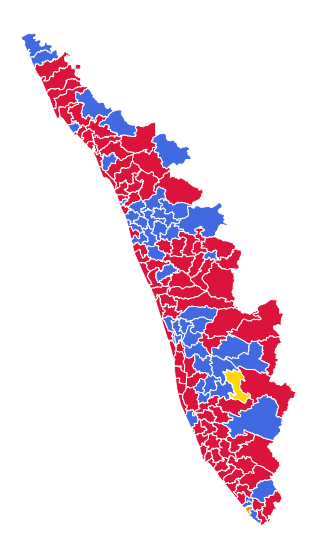

In [8]:
fig, ax = plt.subplots(figsize=(20, 10)) 
map_data[map_data['winner_alliance'] == 'LDF'].plot(ax=ax, color='crimson', linewidth = 1, edgecolor='white')
map_data[map_data['winner_alliance'] == 'UDF'].plot(ax=ax, color='royalblue', linewidth = 1, edgecolor='white')
map_data[map_data['winner_alliance'] == 'NDA'].plot(ax=ax, color='darkorange', linewidth = 1, edgecolor='white')
map_data[map_data['winner_alliance'] == 'IND'].plot(ax=ax, color='gold', linewidth = 1, edgecolor='white')
plt.axis('off')
plt.show()

In [9]:
def plot_seats_won_by_alliance(alliance, color):
    fig, ax = plt.subplots(figsize=(20, 10))
    gdf.plot(ax=ax, color='whitesmoke', linewidth = 0.2, edgecolor='black')
    map_data[map_data['winner_alliance'] == alliance].plot(ax=ax, color=color, linewidth = 0.2, edgecolor='black')
    plt.axis('off')
    plt.title('Seats won by ' + alliance)
    plt.show()

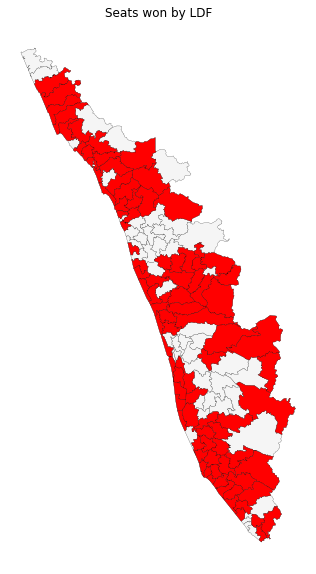

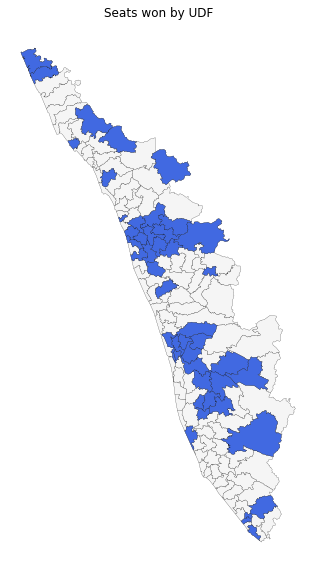

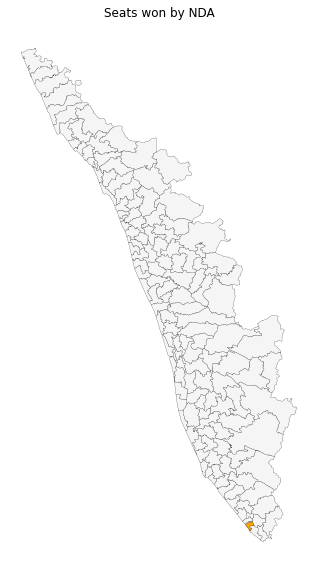

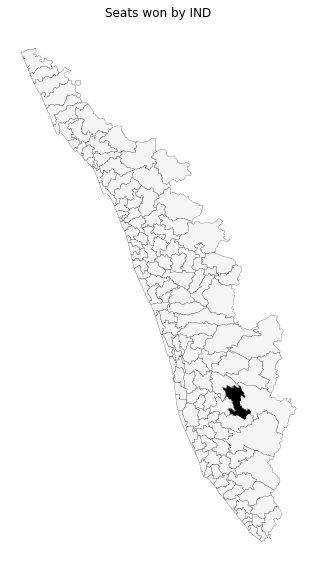

In [10]:
plot_seats_won_by_alliance('LDF', 'red')
plot_seats_won_by_alliance('UDF', 'royalblue')
plot_seats_won_by_alliance('NDA', 'orange')
plot_seats_won_by_alliance('IND', 'black')

In [11]:
def plot_seats_won_by_party(party, color):
    fig, ax = plt.subplots(figsize=(20, 10))
    gdf.plot(ax=ax, color='whitesmoke', linewidth = 0.2, edgecolor='black')
    map_data[map_data['winner_party'] == party].plot(ax=ax, color=color, linewidth = 0.2, edgecolor='black')
    plt.axis('off')
    plt.title('Seats won by ' + party)
    plt.show()

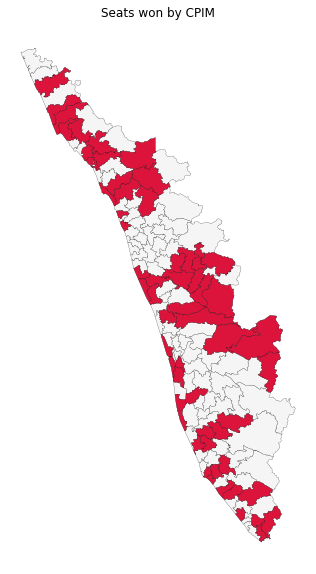

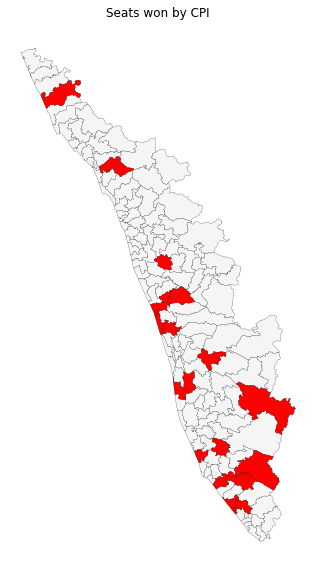

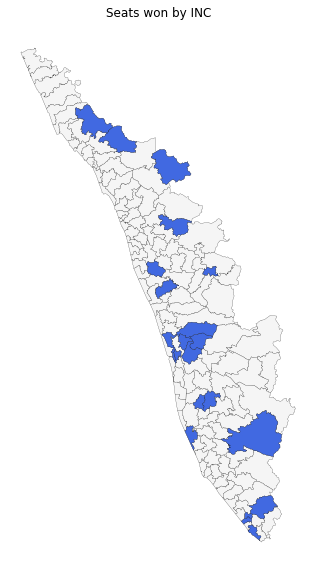

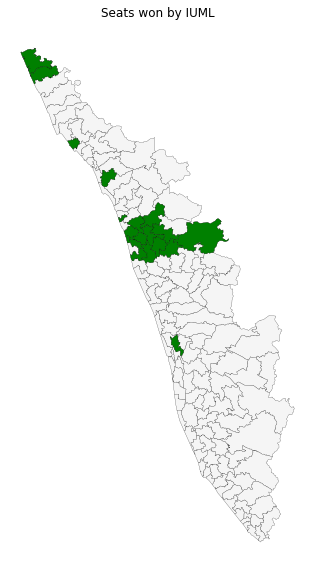

In [12]:
plot_seats_won_by_party('CPIM', 'crimson')
plot_seats_won_by_party('CPI', 'red')
plot_seats_won_by_party('INC', 'royalblue')
plot_seats_won_by_party('IUML', 'green')

In [13]:
# plotly express chorpleth map need shape file geojson format

# new file location
new_geojson_file = "C:\\Users\\imdevskp\\Documents\\kerala_election\\map\\kerala\\kerala.json"
# save data as a geojson fle
map_data[['AC_NAME', 'geometry']].to_file(new_geojson_file, driver="GeoJSON")
# read geojson file 
with open("C:\\Users\\imdevskp\\Documents\\kerala_election\\map\\kerala\\kerala.json") as f:
    data = json.load(f)

In [14]:
# ploting interactive map
fig = px.choropleth_mapbox(map_data, geojson=data, color="winner_alliance",
                           locations="AC_NAME", featureidkey="properties.AC_NAME", 
                           center={"lat":10.5, "lon":76.3}, mapbox_style="carto-positron",
                           zoom=6.5, height = 780, width = 700, 
                           color_discrete_sequence=['#28527a', '#fa1e0e', '#75cfb8', '#f4d160'])
fig.show()

In [15]:
cmap_alliance = {"LDF": "#fa1e0e", 
                 "UDF": "#28527a",
                 "IND": "#75cfb8",
                 "NDA": "#f4d160"}

In [16]:
map_data['winner_party'].unique()

array(['IUML', 'CPIM', 'CPI', 'INC', 'CS', 'JDS', 'NCP', 'LDF', 'NSC',
       'KCA', 'KCM', 'IND', 'CMPA', 'RSPL', 'KCB', 'BJP'], dtype=object)

In [17]:
# ploting interactive map
fig = px.choropleth_mapbox(map_data, geojson=data, color="winner_alliance",
                           locations="AC_NAME", featureidkey="properties.AC_NAME", 
                           center={"lat":10.5, "lon":76.3}, mapbox_style="carto-positron",
                           zoom=6.5, height = 780, width = 700, 
                           color_discrete_map=cmap_alliance)
fig.show()

In [18]:
cmap_party = {"IUML":"#00917c",
              'CPIM':'#fa1e0e',
              'CPI':'#ff5e78',
              'INC':'#3f72af',
              'CS':'#ffde7d',
              'JDS':'#f9ed69',
              'NCP':'#a8d8ea',
              'LDF':'#ff9999',
              'NSC':'#ff9999',
              'KCA':'#95e1d3',
              'KCM':'#51c2d5',
              'IND':'#351f39',
              'CMPA':'#ff9999',
              'RSPL':'#ff9999',              
              'KCB':'#a3d2ca',
              'BJP':'#ff9a00'}              

In [19]:
# ploting interactive map
fig = px.choropleth_mapbox(map_data, geojson=data, color="winner_party",
                           locations="AC_NAME", featureidkey="properties.AC_NAME", 
                           center={"lat":10.5, "lon":76.3}, mapbox_style="carto-positron",
                           zoom=6.5, height = 780, width = 700, 
                           color_discrete_map=cmap_party)
fig.show()

In [20]:
# fig, ax = plt.subplots(figsize=(20, 10))
# gdf.plot(ax=ax, color='whitesmoke', linewidth = 0.2, edgecolor='black')
# map_data[map_data['winner_alliance'] == 'LDF'].plot(ax=ax, color='crimson', linewidth = 0.2, edgecolor='black')

In [21]:
# fig, ax = plt.subplots(figsize=(20, 10))
# gdf.plot(ax=ax, color='whitesmoke', linewidth = 0.2, edgecolor='black')
# map_data[map_data['winner_alliance'] == 'UDF'].plot(ax=ax, color='royalblue', linewidth = 0.2, edgecolor='black')

In [22]:
# fig, ax = plt.subplots(figsize=(20, 10))
# gdf.plot(ax=ax, color='whitesmoke', linewidth = 0.2, edgecolor='black')
# map_data[map_data['winner_alliance'] == 'NDA'].plot(ax=ax, color='darkorange', linewidth = 0.2, edgecolor='black')

In [23]:
# fig, ax = plt.subplots(figsize=(20, 10))
# gdf.plot(ax=ax, color='whitesmoke', linewidth = 0.2, edgecolor='black')
# map_data[map_data['winner_party'] == 'CPIM'].plot(ax=ax, color='crimson', linewidth = 0.2, edgecolor='black')

In [24]:
# fig, ax = plt.subplots(figsize=(20, 10))
# gdf.plot(ax=ax, color='whitesmoke', linewidth = 0.2, edgecolor='black')
# map_data[map_data['winner_party'] == 'CPIM'].plot(ax=ax, column = 'lead', cmap='OrRd', linewidth = 0.2, edgecolor='black')

In [25]:
# fig, ax = plt.subplots(figsize=(20, 10))
# gdf.plot(ax=ax, color='whitesmoke', linewidth = 0.2, edgecolor='black')
# map_data[map_data['winner_party'] == 'CPI'].plot(ax=ax, column = 'lead', cmap='OrRd', linewidth = 0.2, edgecolor='black')

In [26]:
# fig, ax = plt.subplots(figsize=(20, 10))
# gdf.plot(ax=ax, color='whitesmoke', linewidth = 0.2, edgecolor='black')
# map_data[map_data['winner_party'] == 'INC'].plot(ax=ax, color='cornflowerblue', linewidth = 0.2, edgecolor='black')

In [27]:
# fig, ax = plt.subplots(figsize=(20, 10))
# gdf.plot(ax=ax, color='whitesmoke', linewidth = 0.2, edgecolor='black')
# map_data[map_data['winner_party'] == 'IUML'].plot(ax=ax, color='green', linewidth = 0.2, edgecolor='black')

In [28]:
# map_data[map_data['winner_alliance'] == 'LDF'].plot(ax=ax, column='lead', cmap='Reds', linewidth = 1, edgecolor='white')

In [29]:
# fig, ax = plt.subplots(figsize=(20, 10)) 
# map_data[map_data['winner_alliance'] == 'LDF'].plot(ax=ax, column='lead', cmap='OrRd', linewidth = 1, edgecolor='white')
# map_data[map_data['winner_alliance'] == 'UDF'].plot(ax=ax, column='lead', cmap='PuBu', linewidth = 1, edgecolor='white')
# map_data[map_data['winner_alliance'] == 'NDA'].plot(ax=ax, column='lead', cmap='Oranges', linewidth = 1, edgecolor='white')
# map_data[map_data['winner_alliance'] == 'IND'].plot(ax=ax, column='lead', cmap='Greys', linewidth = 1, edgecolor='white')

In [31]:
# fig, ax = plt.subplots(figsize=(20, 10)) 
# map_data[map_data['winner_alliance'] == 'LDF'].plot(ax=ax, column='lead', cmap='Reds', linewidth = 1, edgecolor='white')
# map_data[map_data['winner_alliance'] == 'UDF'].plot(ax=ax, column='lead', cmap='Blues', linewidth = 1, edgecolor='white')

In [32]:
print('hello')

hello
